# Web-scraping: сбор данных из баз данных и интернет-источников

*Алла Тамбовцева, НИУ ВШЭ*

## Работа с текстами: анализ тональности и облака слов

### Часть 1: подготовка данных

Импортируем библиотеку `pandas`: 

In [1]:
import pandas as pd

Библиотека `requests` нам сегодня не понадобится, мы будем работать с готовым файлом `comments-as-rows.csv`, в котором сохранены все посты со стены [сообщества](https://vk.com/rzclimbing) скалодрома RockZona ВКонтакте:

In [2]:
df = pd.read_csv("comments-as-rows.csv")

In [3]:
df.head()

,Unnamed: 0,post_id,post_date,post_text,nlikes,nreposts,comm_id,user_id,comm_date,comm_text,thread
0,0,3876,1675521692,NaN,22,2,3877,712087291,1675622535,Очень круто… 🤣,"{'count': 0, 'items': [], 'can_post': True, 's..."
1,1,3868,1674902631,NaN,27,3,3869,196636514,1674936716,Не скручивайте 6-ку по красным зацепкам на сте...,"{'count': 0, 'items': [], 'can_post': True, 's..."
2,2,3858,1674146111,NaN,22,1,3859,185384079,1674148446,NaN,"{'count': 0, 'items': [], 'can_post': True, 's..."
3,3,3858,1674146111,NaN,22,1,3860,41414377,1674157341,Пора полный метр снимать👍,"{'count': 0, 'items': [], 'can_post': True, 's..."
4,4,3856,1674042051,Кампус и фингерборд — отличные инструменты для...,30,11,3857,-38936316,1674042052,#скалодорммосква #скалодром #скалолазаниевмоск...,"{'count': 0, 'items': [], 'can_post': True, 's..."


Пояснения по названиям столбцов:
    
* `post_id`: id поста;
* `post_date`: дата публикации поста (POSIX формат);
* `post_text`: текст поста;
* `nlikes`: число лайков;
* `nreposts`: число репостов;
* `comm_id`: id комментария; 
* `user_id`: id пользователя, оставившего комментарий;
* `comm_text`: текст комментария;
* `thread`: ответы на комментарий в виде словаря с разными характеристиками.

В полученном датафрейме одна строка соответствует одному комментарию, а не посту, поэтому id, тексты и прочие характеристики постов повторяются, а вот комментарии от строки к строке меняются. 

Оставим в датафрейме `df` только те строки, которые соответствуют постам с текстом. Можно удалить строки с пропусками, а мы, наоборот, выберем те строки, где значение `post_text` непустое, применив метод `.notnull()`:

In [4]:
df = df[df["post_text"].notnull()] 

Так как впереди нам предстоит работать исключительно с постами, давайте получим сокращённую версию датафрейма – избавимся от строк с повторяющимися значениями в столбце `post_id`, оставив только последнее из повторений (можно забрать и первое, отличия только в комментариях, а нас они пока не интересуют):

In [5]:
df_post = df.drop_duplicates(subset="post_id", keep = "last")

In [6]:
df_post.head(3)

,Unnamed: 0,post_id,post_date,post_text,nlikes,nreposts,comm_id,user_id,comm_date,comm_text,thread
4,4,3856,1674042051,Кампус и фингерборд — отличные инструменты для...,30,11,3857,-38936316,1674042052,#скалодорммосква #скалодром #скалолазаниевмоск...,"{'count': 0, 'items': [], 'can_post': True, 's..."
6,6,3847,1673273731,Как втянуться в тренировочный режим после праз...,31,4,3848,260091507,1673504662,У меня есть альтернативное предложение: отказа...,"{'count': 0, 'items': [], 'can_post': True, 's..."
8,8,3838,1672414128,В эту среду у нас на скалодроме прошел новогод...,19,1,3840,-38936316,1672416207,Полные результаты \n\nЛюбители :\n\n1.Гончаров...,"{'count': 0, 'items': [], 'can_post': True, 's..."


Отлично! Формат датафрейма подходит для дальнейшей задачи – анализа тональности постов.

### Часть 2: анализ тональности с билиотекой `dostoevsky`

Анализ тональности – определение эмоциональной окрашенности текста. С его помощью можно определить, позитивный ли перед нами текст, негативный или вообще нейтральный. 

Для анализа тональности мы будем использовать библиотеку `dostoevsky`. Эта библиотека разработана специально для русского языка, к тому же в неё входит модель, которая обучена на текстах из социальных сетей, что делает её особенно полезной для решения прикладных задач (всё-таки алгоритмы, которые учатся распознавать тональность текстов на твитах, постах или отзывах ближе к реальности, чем алгоритмы, обученные на стандартном корпусе литературных текстов).

Использовать библиотеку довольно просто, достаточно повторить действия, описанные в [документации](https://github.com/bureaucratic-labs/dostoevsky), однако с установкой библиотеки иногда возникают сложности. Проблема заключается в том, что эта библиотека зависит от библиотеки `fasttext`, которая используется для быстрой обработки текстов на разных языках, а она, в свою очередь, не работает на Windows без специальных дополнений, позволющих запускать код на C++ (собственно, именно из-за «ядра» на C++ всё быстро и работает).

Итак, порядок действий такой:

1. Попробовать запустить код `!pip install dostoevsky` для установки библиотеки в Jupyter. Если выводится ошибка, связанная с отсутствием/невозможностью установить `fasttext`, пробуем установить `fasttext` через `!pip install fasttext`. 

2. При установке `fasttext` Python выдаст сообщение об ошибке с актуальной ссылкой на Visual Studio C++ Build Tools. Если позволяет память компьютера, лучше установить все компоненты для простоты, но если хочется сократить список, можно выбрать только ключевые, см. перечень [здесь](https://medium.com/@oleg.tarasov/building-fasttext-python-wrapper-from-source-under-windows-68e693a68cbb) в *Step 2*.

3. После установки компонентов Visual Studio C++ Build Tools (ключевое – это компилятор кода на C++) снова пробуем установить `fasttext` через `!pip install fasttext` или сразу `dostoevsky` через  `!pip install dostoevsky`. Должно установиться! 

В крайнем случае можно установить `dostoevsky` в Google Colab, среда находится на сервере, работающим на Ubuntu, это Unix-система, не Windows.

Устанавливаем библиотеку:

In [ ]:
!pip install dostoevsky

После успешной установки скачиваем модель, которая будет предсказывать тональность текста:

In [ ]:
!python -m dostoevsky download fasttext-social-network-model

Импортируем классы `RegexTokenizer` и `FastTextSocialNetworkModel`, которые позволят создать токенизатор (инструмент для правильного разбиения текста на слова) и модель для предсказания тональности текста:

In [7]:
from dostoevsky.tokenization import RegexTokenizer
from dostoevsky.models import FastTextSocialNetworkModel

Класс – это довольно абстрактная вещь, это некоторый объект и его описание одновременно. Например, в библиотеке `pandas` ключевой объект – это датафрейм. Это класс, названный `DataFrame`, на котором разработчики библиотеки определили разные атрибуты и методы (и они же определили, как они работают). Так, с помощью функции `DataFrame()` мы создаём новый датафрейм, а затем можем применять к нему различные методы вроде `.describe()`, `.head()`, `.dropna()`. 

Здесь происходит то же самое, только создаются более непривычные объекты со своими методами и характеристиками:

In [8]:
tokenizer = RegexTokenizer()
model = FastTextSocialNetworkModel(tokenizer = tokenizer)

Теперь, применяя метод `.predict()` к модели, которую мы определили ранее, мы сможем предсказать вероятности того, что текст поста относится к тому или иному типу. Всего в данной модели предусмотрено 5 типов:

* `positive`: положительно окрашенный;
* `negative`: отрицательно окрашенный;
* `neutral`: нейтральный;
* `speech`: приветствия, благодарности и подобные элементы речи;
* `skip`: неидентифицируемые случаи (реклама, шутки, цитаты, стихи);

Эти типы «унаследованы» от проекта [RuSentiment](https://github.com/text-machine-lab/rusentiment).

Мы выберем все 5 типов, потому что при меньшем числе типов будут отобраны самые вероятные, а они у разных постов будут разные.

In [9]:
results = model.predict(df_post["post_text"], k = 5)

Так как модель уже готова и загружена, предсказание вероятностей происходит очень быстро. Посмотрим на первый результат – описание первого поста:

In [10]:
results[0]

{'neutral': 0.6859594583511353,
 'negative': 0.19194278120994568,
 'skip': 0.14415885508060455,
 'positive': 0.06009664759039879,
 'speech': 0.009135636501014233}

Результат представлен в виде словаря, где ключами являются названия типов, а значениями – вероятности, с которыми текст можно отнести к этому типу, согласно модели. Сохраним все эти вероятности в отдельный столбец датафрейма:

In [14]:
df_post["results"] = results

А теперь по уже знакомой схеме извлечём из словаря вероятности для трёх самых понятных типов (положительный, отрицательный, нейтральный):

In [15]:
df_post["positive"] = df_post["results"].apply(lambda x: x["positive"])
df_post["negative"] = df_post["results"].apply(lambda x: x["negative"])
df_post["neutral"] = df_post["results"].apply(lambda x: x["neutral"])

In [16]:
df_post.head()

,Unnamed: 0,post_id,post_date,post_text,nlikes,nreposts,comm_id,user_id,comm_date,comm_text,thread,results,positive,negative,neutral
4,4,3856,1674042051,Кампус и фингерборд — отличные инструменты для...,30,11,3857,-38936316,1674042052,#скалодорммосква #скалодром #скалолазаниевмоск...,"{'count': 0, 'items': [], 'can_post': True, 's...","{'neutral': 0.6859594583511353, 'negative': 0....",0.060097,0.191943,0.685959
6,6,3847,1673273731,Как втянуться в тренировочный режим после праз...,31,4,3848,260091507,1673504662,У меня есть альтернативное предложение: отказа...,"{'count': 0, 'items': [], 'can_post': True, 's...","{'neutral': 0.7186043858528137, 'negative': 0....",0.053413,0.152042,0.718604
8,8,3838,1672414128,В эту среду у нас на скалодроме прошел новогод...,19,1,3840,-38936316,1672416207,Полные результаты \n\nЛюбители :\n\n1.Гончаров...,"{'count': 0, 'items': [], 'can_post': True, 's...","{'neutral': 0.4225146472454071, 'positive': 0....",0.103759,0.051855,0.422515
12,12,3832,1672160535,"Скалолазы часто путают эти два термина, потому...",42,10,3845,227276119,1672808651,"Максимальные подтягивания вроде уже не сила, а...","{'count': 0, 'items': [], 'can_post': True, 's...","{'neutral': 0.6723417043685913, 'negative': 0....",0.050341,0.182436,0.672342
16,16,3822,1672063603,📢 28 декабря в 20:30 состоится мастер-класс по...,23,2,3842,652316910,1672585395,"Жаль, поздно увидел, как раз в этом году хотел...","{'count': 1, 'items': [{'id': 3853, 'from_id':...","{'neutral': 0.6442351341247559, 'positive': 0....",0.191943,0.050341,0.644235


Теперь мы можем, например, сортировать посты по степени их «позитивности»:

In [17]:
# топ 10 положительно окрашенных постов

df_post.sort_values("positive", ascending = False).head(10)

,Unnamed: 0,post_id,post_date,post_text,nlikes,nreposts,comm_id,user_id,comm_date,comm_text,thread,results,positive,negative,neutral
1413,1413,11,1338737076,красивая)),2,0,12,57556726,1338780593,Ага...,"{'count': 0, 'items': [], 'can_post': True, 's...","{'positive': 0.9994907379150391, 'neutral': 0....",0.999491,0.000010,0.182436
1376,1376,145,1357989761,Душевная приятная атмосфера!\nТренироваться оч...,5,0,148,2317267,1358029937,"да-да...один раз пришла, тут и осталась:)","{'count': 0, 'items': [], 'can_post': True, 's...","{'positive': 0.9763205647468567, 'negative': 0...",0.976321,0.019134,0.008326
1411,1411,18,1340302672,"ДДС, Бауманка, Впервые приехал в RockZona - от...",1,0,32,2968349,1344194160,"ага... почаще, Леха.... Ну и это... друзей при...","{'count': 0, 'items': [], 'can_post': True, 's...","{'positive': 0.9615437984466553, 'skip': 0.152...",0.961544,0.055015,0.006108
1412,1412,16,1339706571,Ребята! Супер! Первый раз пришли сегодня :),1,0,17,11873065,1339768281,круто!приходите еще)),"{'count': 0, 'items': [], 'can_post': True, 's...","{'positive': 0.9416641592979431, 'skip': 0.039...",0.941664,0.002193,0.012442
1399,1399,73,1350741531,УРА! ОТЛИЧНАЯ НОВОСТЬ! У нас на скалодроме нак...,7,1,74,1707136,1350745016,мне нравится фотография!,"{'count': 0, 'items': [], 'can_post': True, 's...","{'positive': 0.9219318628311157, 'negative': 0...",0.921932,0.103759,0.037337
801,801,1505,1441629842,Получать письма так приятно. Особенно такие пи...,7,0,1511,29269822,1441869185,"Слава богу, что не каждый день приходят) \nА с...","{'count': 0, 'items': [], 'can_post': True, 's...","{'positive': 0.7931159734725952, 'skip': 0.182...",0.793116,0.053413,0.098089
1176,1176,704,1401285585,Monkey style или Денис - отличный комментатор)),6,0,720,224938447,1404236877,Прикольно лазает.,"{'count': 0, 'items': [], 'can_post': True, 's...","{'positive': 0.6442351341247559, 'neutral': 0....",0.644235,0.006108,0.217348
62,62,3662,1663174172,Друзья!\nНа нашем скалодроме пополнение!\nПодг...,17,0,3663,3691806,1663176016,В какое время не проводятся занятия у детских ...,"{'count': 1, 'items': [{'id': 3665, 'from_id':...","{'positive': 0.6224693655967712, 'neutral': 0....",0.622469,0.046044,0.103759
719,719,1687,1450648150,А мы во всю готовим уже красиво перекрашенный ...,23,1,1691,14724056,1450650350,Ох уж эти зацепки),"{'count': 0, 'items': [], 'can_post': True, 's...","{'positive': 0.585111141204834, 'neutral': 0.2...",0.585111,0.035155,0.217348
1327,1327,337,1376163887,Перекраска и перекрут нашего зала RockZona иде...,18,2,344,86412465,1376229480,Ого !!!Вот это дааа))Молодцы!!),"{'count': 0, 'items': [], 'can_post': True, 's...","{'positive': 0.5698626637458801, 'neutral': 0....",0.569863,0.090103,0.106701


Или «негативности»:

In [18]:
# топ 10 отрицательно окрашенных постов
# с определением негатива тут есть проблемы

df_post.sort_values("negative", ascending = False).head(10)

,Unnamed: 0,post_id,post_date,post_text,nlikes,nreposts,comm_id,user_id,comm_date,comm_text,thread,results,positive,negative,neutral
1384,1384,137,1356792563,Итоговые протоколы Серьезных стартов - 49 (Нов...,1,2,138,1400902,1356896720,В протоколах косяк. У меня в отборках 9 трасс....,"{'count': 0, 'items': [], 'can_post': True, 's...","{'neutral': 0.7310686111450195, 'negative': 0....",0.015916,0.492198,0.731069
1070,1070,890,1414162231,Уважаемые посетители!!\nВ БЦ Нагатинский был с...,3,1,897,134389062,1414267728,"буду рада помочь,если свободна буду)))","{'count': 0, 'items': [], 'can_post': True, 's...","{'negative': 0.4378334879875183, 'positive': 0...",0.348655,0.437833,0.156115
1084,1084,875,1413976479,Внимание !!!\nУважаемые посетители !! \nСкалод...,5,3,879,4697445,1413977372,Перенесём)),"{'count': 0, 'items': [], 'can_post': True, 's...","{'neutral': 0.546748161315918, 'negative': 0.3...",0.067557,0.392347,0.546748
729,729,1663,1450264384,Одним из спонсоров наших соревнований стал...,8,0,1666,1289135,1450269817,Неожиданно...,"{'count': 0, 'items': [], 'can_post': True, 's...","{'negative': 0.3923468291759491, 'skip': 0.212...",0.035155,0.392347,0.173298
1189,1189,672,1398936550,Хотел прийти к вам на 2-ое мая... звонил с 10 ...,0,0,673,11873065,1398977487,"Очень странно! Телефон сегодня работал, мы зав...","{'count': 0, 'items': [], 'can_post': True, 's...","{'neutral': 0.5000100135803223, 'negative': 0....",0.039649,0.392347,0.500010
667,667,1852,1461218652,Над фотографиями скалолазов и альпинистов час...,32,2,1853,1461673,1461220073,Очень наглядно:))))),"{'count': 0, 'items': [], 'can_post': True, 's...","{'neutral': 0.8031837940216064, 'negative': 0....",0.004080,0.392347,0.803184
87,87,3557,1656936690,Опытные скалолазы достаточно хорошо знают свои...,7,1,3558,-38936316,1656936691,#скалолазание\n#скалолазанье\n#скальники\n#вве...,"{'count': 0, 'items': [], 'can_post': True, 's...","{'neutral': 0.6150978803634644, 'negative': 0....",0.055015,0.314061,0.615098
95,95,3535,1655999322,"Мало кто знает, что избыточное потребление жид...",12,2,3538,260091507,1656006216,"Грамотно написано, насколько способен судить. ...","{'count': 3, 'items': [{'id': 3540, 'from_id':...","{'neutral': 0.44553956389427185, 'negative': 0...",0.136618,0.307368,0.445540
1308,1308,355,1376254686,Пошли уже третьи сутки непрерывных работ на ск...,16,0,367,1102447,1376383228,"ух ты, классно как!!!","{'count': 0, 'items': [], 'can_post': True, 's...","{'neutral': 0.29422497749328613, 'negative': 0...",0.040856,0.281416,0.294225
59,59,3680,1664208815,В последнее время в связи с популярностью кето...,14,0,3681,260091507,1664225625,"Эх, товарищи!.. Не всё так просто с углеводами...","{'count': 1, 'items': [{'id': 3683, 'from_id':...","{'neutral': 0.538993239402771, 'negative': 0.2...",0.095359,0.281416,0.538993


Как использовать эту информацию далее – зависит от исследователя. Можно ввести свою классификацию тональности, например, считать пост положительным, если вероятность класса `positive` выше вероятности класса `negative`, можно изучать, какие слова чаще используются в «позитивных» постах, а какие – в «негативных», можно разделить все посты на группы и сравнивать, насколько часто пользователи лайкают посты разных типов... А можно перейти к анализу комментариев и изучать характеристики пользователей, которые оставляют положительные или отрицательные комментарии (но это просто звучит в теории, на практике далеко не по всем пользователям можно будет собрать достаточно интересную информацию, профили часто закрыты).

### Часть 3: облака слов

Перейдём к ещё одной задаче, связанной с изучением текстов, к построению облаков слов (*word clouds*). Облака слов позволяют визуализировать ответы на вопросы, связанные с частотой упоминания слов в тексте. 

Для построения облаков слов нам понадобится библиотека `wordcloud` (она должна устанавливаться без проблем):

In [ ]:
!pip install wordcloud

Для построения облака слов нам нужен текст, состоящий только из слов, без посторонних символов. Приступим к предварительной обработке текста. 

Выберем тексты всех постов из датафрейма и склеим их в один большой текст через `.join()`, а затем приведём все буквы в тексте к нижнему регистру через `.lower()`:

In [19]:
text = " ".join(df_post["post_text"]).lower() 

# фрагмент для примера
print(text[0:98])

кампус и фингерборд — отличные инструменты для тренировок. но риск травм пальцев все же есть.   




Заменим символы для перехода на новую строку и неразрывные пробелы на обычные пробелы:

In [20]:
text = text.replace("\n", " ").replace("\xa0", " ")

По-хорошему, цифры тоже нужно убрать, но так как вряд ли они выйдут в топ по своей встречаемости, в рамках решения поставленной задачи оставим их на месте. Однако знаки пунктуации надо удалить!

Воспользуемся готовым перечнем из модуля `string`:

In [21]:
from string import punctuation

In [22]:
print(punctuation)

!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~


Объект `punctuation` – самая обычная строка со знаками препинания. Доклеим к ней недостающие символы – длинное тире и русские кавычки «ёлочки» (да, это вполне официальное название, английские кавычки называются «лапками»):

In [23]:
punctuation = punctuation + "—" + "«»" 

Теперь осуществим замену – заменим все знаки препинания в тексте (из `punctuation`) на пробелы:

In [24]:
for p in punctuation:
    text = text.replace(p, " ")
    
# фрагмент текста
print(text[0:98])

кампус и фингерборд   отличные инструменты для тренировок  но риск травм пальцев все же есть      


Текст выглядит предобработанным, но ещё не совсем. Почему? Слова в тексте стоят в разных формах, а значит, одинаковые по смыслу слова, стоящие в разных падежах/числах/лицах/временах, будут считаться различными. Для частотного анализа текста это не годится. 

Давайте разобьём текст на отдельные слова и приведём их к единой начальной форме! Так, все существительные будут стоять в единственном числе в именительном падеже, все прилагательные – тоже в единственном числе в именительном падеже, но ещё и в мужском роде, глаголы – в неопределённой форме. Эта процедура называется **лемматизацией** (*лемма* – словарная форма слова). Иногда для унификации слов используют другую процедуру – **стемминг** (от английского *stem* – основа), которая предполагает отсечение всех формообразующих морфем вроде окончаний и суффиксов глаголов, но для нашей цели она не подходит – слова в облаке слов будут некрасиво обрублены. 

Для приведения слов к начальной форме (нормальной форме) нам понадобится библиотека `pymorphy2`. Установим её:

In [ ]:
!pip install pymorphy2

Импортируем:

In [25]:
import pymorphy2

И создаём объект типа «морфологический анализатор», он поможет автоматически сделать морфологический разбор слова и забрать его начальную форму:

In [26]:
morph = pymorphy2.MorphAnalyzer()

Пример работы анализатора для конкретного слова:

In [27]:
morph.parse("стекла")

[Parse(word='стекла', tag=OpencorporaTag('NOUN,inan,neut sing,gent'), normal_form='стекло', score=0.828282, methods_stack=((DictionaryAnalyzer(), 'стекла', 157, 1),)),
 Parse(word='стёкла', tag=OpencorporaTag('NOUN,inan,neut plur,nomn'), normal_form='стекло', score=0.080808, methods_stack=((DictionaryAnalyzer(), 'стёкла', 157, 6),)),
 Parse(word='стёкла', tag=OpencorporaTag('NOUN,inan,neut plur,accs'), normal_form='стекло', score=0.080808, methods_stack=((DictionaryAnalyzer(), 'стёкла', 157, 9),)),
 Parse(word='стекла', tag=OpencorporaTag('VERB,perf,intr femn,sing,past,indc'), normal_form='стечь', score=0.010101, methods_stack=((DictionaryAnalyzer(), 'стекла', 1015, 2),))]

Метод `.parse()` вернул список всех возможных вариантов разбора слова, упорядоченный от наиболее вероятного до наименее вероятного. Так, с самой большой вероятностью слово «стекла» – это родительный падеж слова «стекло» (`NOUN` – существительное, `inan` – неодушевленное, `sing` – единственное число, `gent` – родительный падеж, генитив). 
А с самой маленькой вероятностью это слово является формой глагола «стечь» (`VERB` – глагол, `perf` – прошедшее время, `intr femn` – непереходный глагол, `indc` – изъявительное наклонение, индикатив).

Из списка можно извлечь самый вероятный первый разбор и забрать его начальную форму:

In [28]:
morph.parse("стекла")[0].normal_form

'стекло'

Разобьём наш текст, склеенный из всех постов, на слова и через списковое включение получим для каждого слова начальную форму:

In [29]:
words = text.split()
lemmas = [morph.parse(w)[0].normal_form for w in words]
print(lemmas[0:10])

['кампус', 'и', 'фингерборд', 'отличный', 'инструмент', 'для', 'тренировка', 'но', 'риск', 'травма']


Склеим список лемм в единый текст: 

In [30]:
lemm_text = " ".join(lemmas) 

Отлично! Такой текст можем использовать для построения облака слов. 

Импортируем функцию `WordCloud()` и модуль `pyplot` из `matplotlib`, который используется для отрисовки различных графиков:

In [31]:
from wordcloud import WordCloud
from matplotlib import pyplot as plt 

Сформируем облако слов на основе лемматизированного текста:

In [33]:
wcloud = WordCloud().generate(lemm_text)

Отрисуем полученное облако через функцию `.imshow()` и «выключим» оси, так как метки с числами (как на обычных графиках) нам не нужны:

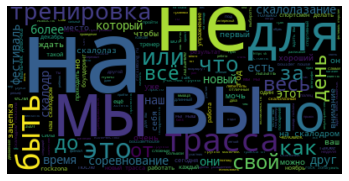

In [34]:
plt.imshow(wcloud, interpolation="bilinear")
plt.axis("off")
plt.show() 

Проблема: облако слов получилось неинформативным! В нём, действительно, собраны самые частые слова вроде предлогов и союзов, а мы явно хотели не этого. На самом деле, наша предварительная обработка текста была выполнена не до конца – мы забыли убрать так называемые **стоп-слова**, самые частые слова в языке, которые обычно исключаются перед анализом текстов. Вариантов добыть стоп-слова для русского языка много: можно подключить специальные бибиотеки вроде `nltk`, можно загрузить список из репозитория какого-нибудь проекта на Github или из готового файла. 

Мы воспользуемся последним способом и скачаем txt-файл со стоп-словами [отсюда](https://countwordsfree.com/stopwords/russian). Откроем файл для чтения, считаем из него строки с помощью метода `.readlines()`: 

In [35]:
f = open("stop_words_russian.txt", "r")
lines = f.readlines()

In [36]:
lines[0:10]

['а\n', 'е\n', 'и\n', 'ж\n', 'м\n', 'о\n', 'на\n', 'не\n', 'ни\n', 'об\n']

Удалим `\n` с помощью метода `.strip()`, который удаляет все лишние пробелы и отступы в начале и конце строки:

In [37]:
stopwords_ru = [line.strip() for line in lines] 
stopwords_ru[0:10]

['а', 'е', 'и', 'ж', 'м', 'о', 'на', 'не', 'ни', 'об']

Построим облако слов заново – поместим список стоп-слов в аргумент `stopwords` внутри функции `WordCloud()`:

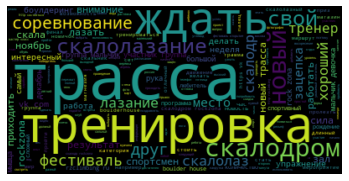

In [38]:
wcloud = WordCloud(stopwords = stopwords_ru).generate(lemm_text)
plt.imshow(wcloud, interpolation="bilinear")
plt.axis("off")
plt.show() 

Выглядит получше, но обычно работа на этом не заканчивается, часто приходится добавлять в список свои стоп-слова, которые характерны для текстов определённой тематики.

Попробуем поиграть с облаком слов и задействовать ещё некоторые параметры. Но сначала сделаем поле для отрисовки графика побольше! Тут стоит вспомнить, что вообще график `matplotlib` состоит из двух частей:

* «рамка» для картинки (обычно сохраняется в переменную `fig`);
* поле с осями, внутри которого строится график (обычно сохраняется как `ax`).

Так, мы можем воспользоваться функцией `subplots()` и сообщить Python, что мы хотим получить картинку размера 16 на 9 дюймов и разрешением 500 точек на дюйм (`dpi` от *dots per inch*):

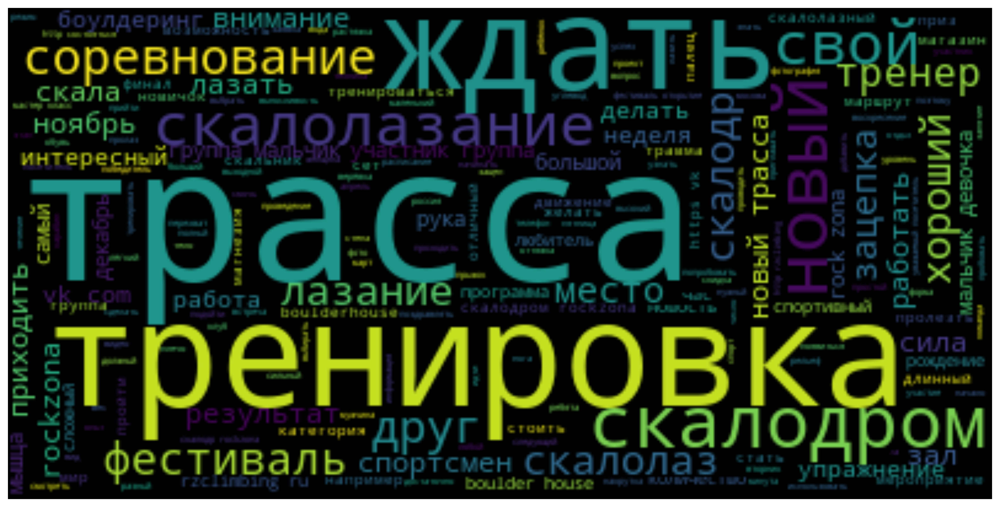

In [39]:
# множественное присваивание, subplots() возвращает сразу 2 элемента

fig, ax = plt.subplots(figsize = (16, 9), dpi = 500) 
plt.imshow(wcloud, interpolation="bilinear")
plt.axis("off")
plt.show() 

Изменим цвет фона облака слов и [палитру](https://matplotlib.org/stable/tutorials/colors/colormaps.html) цветов (внимание: есть элемент случайности, при повторном запуске ячейки цвета меняются!):

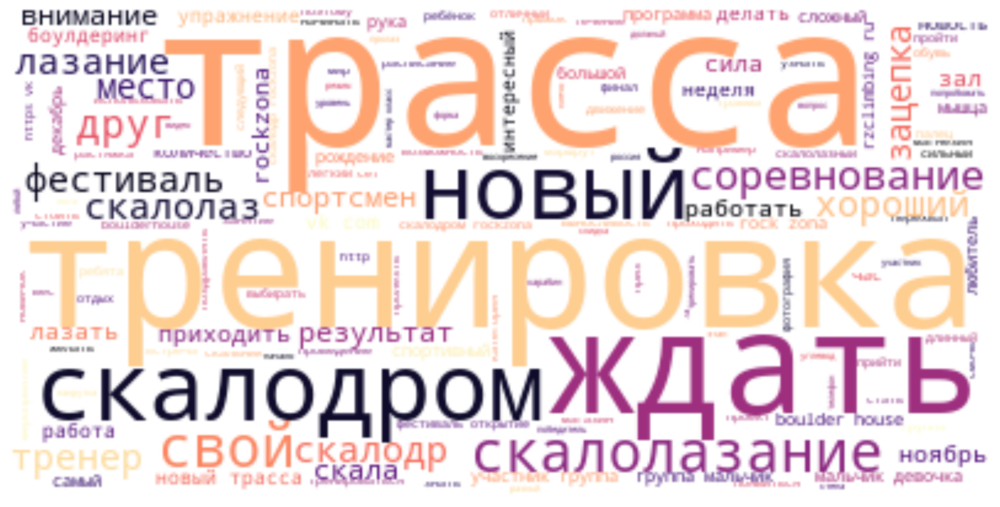

In [41]:
fig, ax = plt.subplots(figsize = (16, 9), dpi = 500) 

# background_color
# colormap

wcloud = WordCloud(stopwords = stopwords_ru,
                  background_color = "white",
                  colormap = "magma").generate(lemm_text)
plt.imshow(wcloud, interpolation="bilinear")
plt.axis("off")
plt.show() 

Сократим число слов в облаке до 100 (по умолчанию их 200):

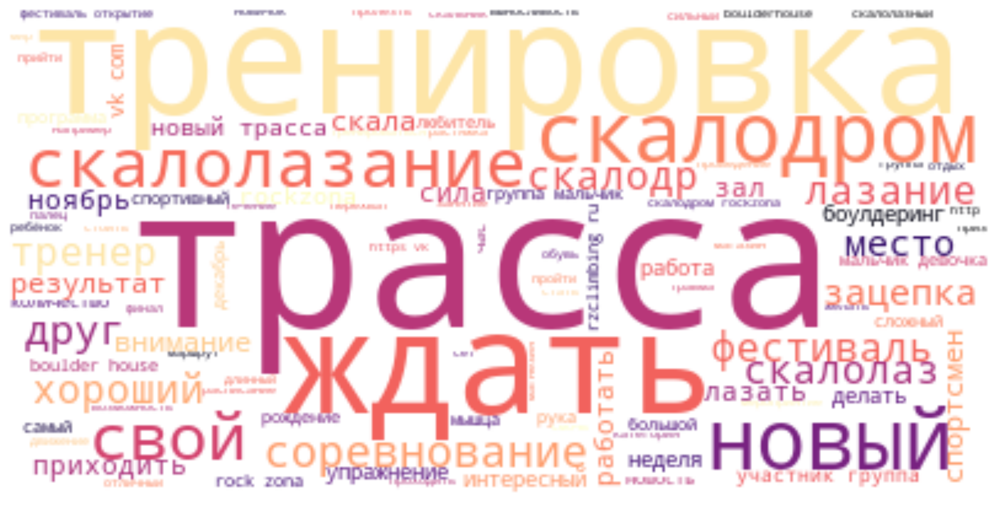

In [42]:
fig, ax = plt.subplots(figsize = (16, 9), dpi = 500) 

# max_words, только 100 самых частых

wcloud = WordCloud(stopwords = stopwords_ru,
                  background_color = "white",
                  colormap = "magma",
                  max_words = 100).generate(lemm_text)
plt.imshow(wcloud, interpolation="bilinear")
plt.axis("off")
plt.show() 

Наконец, в качестве основы для облака слов можно взять изображение, это прекрасно описано в тьюториале [здесь](https://www.datacamp.com/tutorial/wordcloud-python). Подобрать какое-то узнаваемое и простое по форме тематическое изображение в данном случае сложновато (хотя можно было бы выбрать официальный логотип скалодрома), поэтому я просто взяла векторное [изображение с Freepik](https://ru.freepik.com/free-vector/3d-vector-climbing-up-stairs-isolated_10603017.htm#query=stairs%20up&position=0&from_view=search&track=ais).

Импортируем функцию для обработки изображения и библиотеку `numpy`, чтобы потом преобразовать изображение в массив:

In [43]:
from PIL import Image
import numpy as np

Загружаем изображение и создаём массив:

In [44]:
my_mask = np.array(Image.open("42517.jpg"))

Добавляем изображение в качестве маски и сохраняем изображение через функцию `savefig()`:

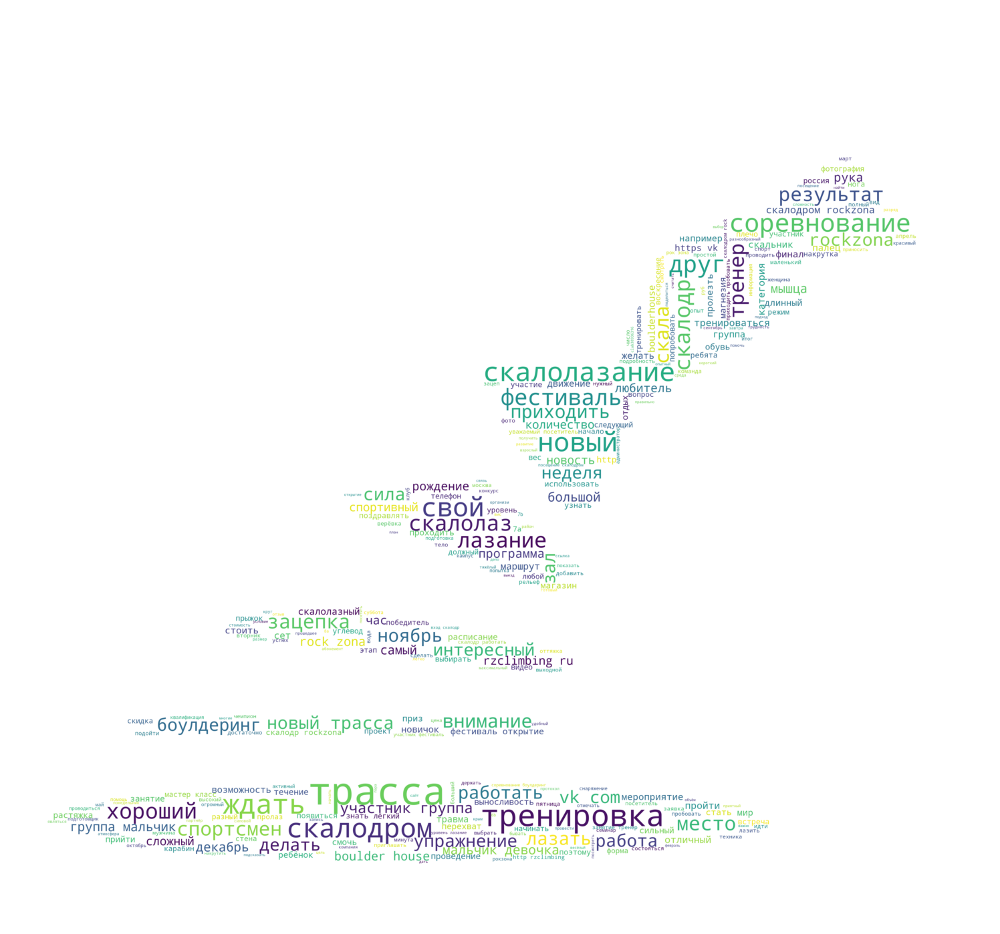

In [45]:
fig, ax = plt.subplots(figsize = (16, 9), dpi = 200) 

# my_mask

wcloud = WordCloud(stopwords = stopwords_ru,
                  background_color = "white",
                  max_words = 300,
                  mask = my_mask).generate(lemm_text)
plt.imshow(wcloud, interpolation="bilinear")
plt.axis("off")
plt.show() 

# сохраняем

fig.savefig("my_cloud.png")